<a href="https://colab.research.google.com/github/Aniket10-IN/Deep-Learning/blob/Branch1/Doggy_Vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶End-to-end Multi-class Dog Breed Classification
This notebook builds an end-to-end multiclass image classifier using TensorFlow 2.0 and Tensorflow Hub.

## 1.Problem
Identifying the breed of a dog given an image of a dog.
When I am at cafe, I took photo of a dog, I want to know what breed of dog it is.
## 2. Data
The data we're using from kaggle's dog breed identification competition.
https://www.kaggle.com/c/dog-breed-identification/data
## 3.Evaluation
The evaluation is file with prediction probabilities for each dog breed of each test image.
https://www.kaggle.com/c/dog-breed-identification/overview/evaluation
## 4.Features
Some information about the data:
* We are dealing with images (structred data) ,so it's probably best using deep learning/ transfer learning.
* There are also 120 breeds of dogs(this means there are 120 different classes).
* There are around 10000 images in training set.(these images are with labels)
* There are around 10000 images in test set. (these images don't have labels because we want to predict them)



In [ ]:
#unzip the uploaded data into google drive
#!unzip "/content/drive/MyDrive/dog-breed-identification.zip" -d "drive/MyDrive/Dog_Vision_data/"

### Get our workspace ready
* import Tensorflow 2.0
* import Tensorflow Hub
* Make sure we're using a GPU

In [ ]:
# import tensorflow into colab
import tensorflow as tf
print("TF version:", tf.__version__)

TF version: 2.4.1


In [ ]:

import tensorflow_hub as hub
print("Tensorflow_Hub version:", hub.__version__)

Tensorflow_Hub version: 0.11.0


In [ ]:
print("GPU", "available (YESSSS!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESSSS!)


### Getting our data ready(Turning into tensors)
With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors(numerical representations).

In [ ]:
# Chekout the labels of our data
import pandas as pd
label_csv = pd.read_csv("drive/MyDrive/Dog_Vision_data/labels.csv")
# we can also use label_csv= pd.read_csv(r"drive/MyDrive/Dog_Vision_data/labels.csv") both deliver same results

In [ ]:
print(label_csv.describe())


                                      id               breed
count                              10222               10222
unique                             10222                 120
top     9424861acb9b6a9f645cd3a8da87bee6  scottish_deerhound
freq                                   1                 126


In [ ]:
label_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:

label_csv["breed"].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
brabancon_griffon        67
golden_retriever         67
komondor                 67
briard                   66
eskimo_dog               66
Name: breed, Length: 120, dtype: int64

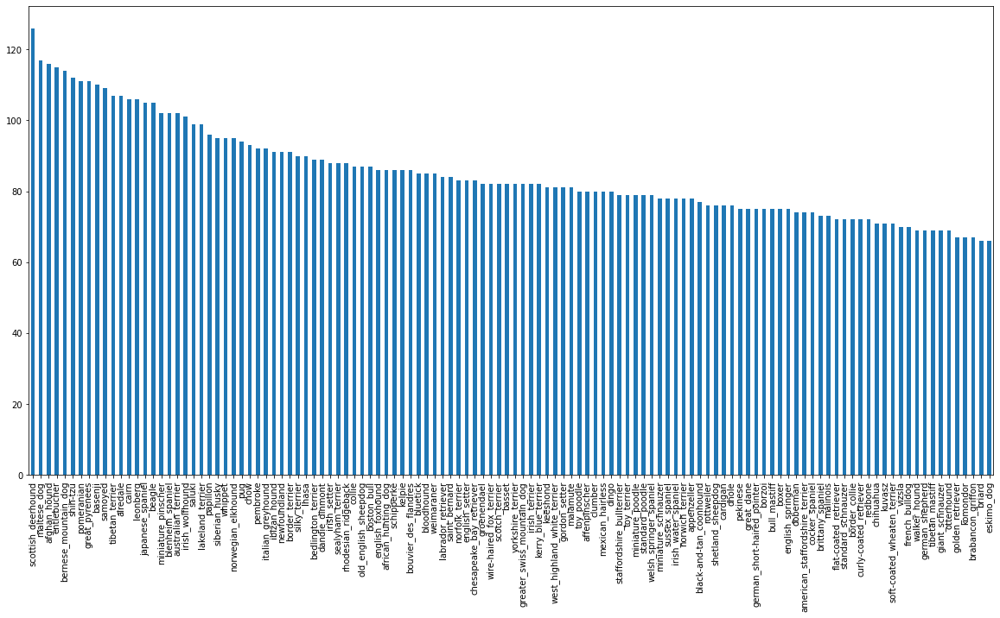

In [ ]:
label_csv["breed"].value_counts().plot.bar(figsize= (20,10))
#notice that we don't have to import matplotlib here

In [ ]:
label_csv["breed"].value_counts().median()

82.0

In [ ]:
from IPython.display import Image

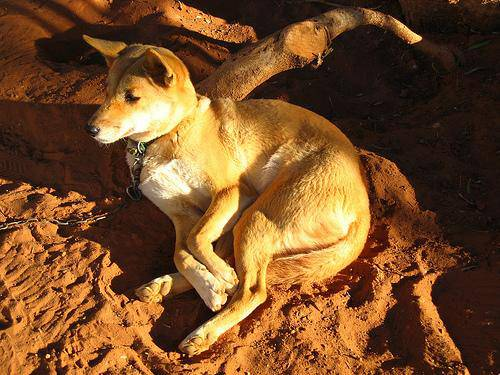

In [ ]:
# Viewing images in our notebook
from IPython.display import Image
Image("drive/MyDrive/Dog_Vision_data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

In [ ]:
# Create pathname ids from Image Id's
filename = [fname for fname in label_csv["id"]] # note that it is a list of id in label_csv data
filename[:10]

['000bec180eb18c7604dcecc8fe0dba07',
 '001513dfcb2ffafc82cccf4d8bbaba97',
 '001cdf01b096e06d78e9e5112d419397',
 '00214f311d5d2247d5dfe4fe24b2303d',
 '0021f9ceb3235effd7fcde7f7538ed62',
 '002211c81b498ef88e1b40b9abf84e1d',
 '00290d3e1fdd27226ba27a8ce248ce85',
 '002a283a315af96eaea0e28e7163b21b',
 '003df8b8a8b05244b1d920bb6cf451f9',
 '0042188c895a2f14ef64a918ed9c7b64']

In [ ]:
filenames = ["drive/MyDrive/Dog_Vision_data/train/"+ fname + ".jpg" for fname in label_csv["id"]]
#check the first 10
filenames[:10]

['drive/MyDrive/Dog_Vision_data/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog_Vision_data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog_Vision_data/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog_Vision_data/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog_Vision_data/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog_Vision_data/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog_Vision_data/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog_Vision_data/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog_Vision_data/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog_Vision_data/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
import os

In [ ]:
# check whether number of filenames matches number of actual image files:
import os
if len(os.listdir("drive/MyDrive/Dog_Vision_data/train/")) == len(filenames):
  print("Filenames match actual amount of files!Proceed")
else:
    print("Filename do not match actual amount of files")

Filenames match actual amount of files!Proceed


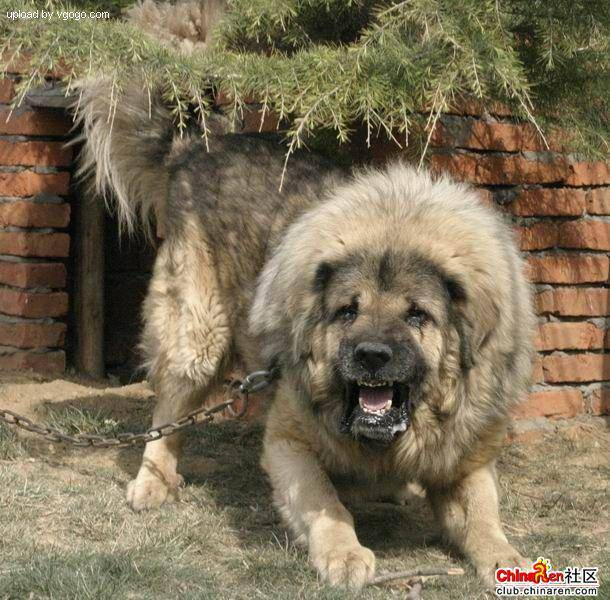

In [ ]:
Image(filenames[9000])

In [ ]:
label_csv['breed'][9000]

'tibetan_mastiff'

Since we have got our training image filepaths in a list, let's prepare our labels

In [ ]:
import numpy as np
labels = label_csv["breed"].to_numpy()
#labels = np.array(labels)# does the same thing as above
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# see if number of labels matches number of filenames
if len(labels)== len(filenames):
  print("Good!!! Proceed")


Good!!! Proceed


In [ ]:
# check unique breeds
unique_breeds = np.unique(labels)
(unique_breeds)

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
len(unique_breeds)

120

In [ ]:
# Turn a single labels into array of booleans
print(labels[0])
labels[0] == unique_breeds 
# Note : here it compares label[0] with rest of the unique_breeds and gives boolean result.


boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# self practice
label_csv['breed'][:5]

0         boston_bull
1               dingo
2            pekinese
3            bluetick
4    golden_retriever
Name: breed, dtype: object

In [ ]:
labels[:5]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever'],
      dtype=object)

In [ ]:
len(boolean_labels)

10222

In [ ]:
# Turn every label into a boolean array
print(labels[:2])
boolean_labels = [label == unique_breeds for label in labels] # note
boolean_labels[:2]

['boston_bull' 'dingo']


[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(boolean_labels)

10222

In [ ]:
# Example: Turning boolean array into integers 
print(labels[0])#original label
print(np.where(unique_breeds == labels[0])) # index where labels occur
print(boolean_labels[0].argmax()) # index where boolean occurs in boolean array(The numpy.argmax() function returns indices of the max element of the array in a particular axis.)
print(boolean_labels[0].astype(int)) # there will be a 1 where sample label occurs 

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[2])
print(boolean_labels[2].astype(int))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set
Since the dataset from kaggle doesn't comes with validation set, we're going to create our own.

In [ ]:
# Setup and y variables 
x = filenames 
y = boolean_labels

In [ ]:
len(filenames)

10222

In [ ]:
len(x), len(y)

(10222, 10222)

We're going to start off experimenting with ~1000 images and increase if needed. 

In [ ]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000}

In [ ]:
# Let's split our data into train and validation sets 
from sklearn.model_selection import train_test_split

# split them into training and validation set of total size NUM_IMAGES
x_train, x_val, y_train, y_val = train_test_split(x[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size = 0.2,
                                                  random_state = 42) 

In [ ]:
len(x_train), len(x_val), len(y_train), len(y_val)

(800, 200, 800, 200)

In [ ]:
#lets have a geez at training data
x_train[:5], y_train[:2]

(['drive/MyDrive/Dog_Vision_data/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog_Vision_data/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/Dog_Vision_data/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/Dog_Vision_data/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/Dog_Vision_data/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, Fal

## Preprocessing images (turning images into numbers)
To preprocess our images into Tensors we're going to write a function which does a few things:
1. Take a image filepath as input.
2. Use tensorflow to read the file and save it to a variable, `image`.
3. Turn our `image`  (a jpg) into Tensors.
4. Normalize our `image` (convert color channel values from 0-255 to 0-1.)
5. Resize the `image` to be a shape of (224,224).
6. Return the modified `image`.
https://www.tensorflow.org/tutorials/load_data/images 

Before we do, let's see what importing an image looks like:

In [ ]:
#convert image to numpy array
from matplotlib.pyplot import imread #matplotlib fn. used to read images 
image = imread(filenames[42])
image.shape
# the result below gives height,width and RGB(red,green, blue)

(257, 350, 3)

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
image[:2]

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)

In [ ]:
# turn image into tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

> Now we have seen what an image looks like as a Tensors, let's make a function to preprocess them .

In [ ]:
# Define image size
IMG_SIZE = 224
# Create a function for preprocessing images 
def process_image(image_path):
  """
  Takes an image filepath and turn the images into tensors
  """
  #Read an image file
  image = tf.io.read_file(image_path)
  #turn jpeg images into numerical tensors with 3 color channels (Red,Green,Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  #convert the color channel values from 0-255 to 0-1 values.
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired values(224,224)
  image = tf.image.resize(image, size = [IMG_SIZE, IMG_SIZE])

  return image

In [ ]:
#lets see what above codes results in individually
tensor = tf.io.read_file(filenames[26])
tensor

<tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\n\x07\x07\x08\x07\x06\n\x08\x08\x08\x0b\n\n\x0b\x0e\x18\x10\x0e\r\r\x0e\x1d\x15\x16\x11\x18#\x1f%$"\x1f"!&+7/&)4)!"0A149;>>>%.DIC<H7=>;\xff\xdb\x00C\x01\n\x0b\x0b\x0e\r\x0e\x1c\x10\x10\x1c;("(;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\xff\xc0\x00\x11\x08\x01\xf4\x01w\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca

In [ ]:
#converting images into numerical tensors
tensor =tf.image.decode_jpeg(tensor, channels=3)

In [ ]:
# Normalizing (from 0-255 values to 0-1 values)
tf.image.convert_image_dtype(tensor, tf.float32)

<tf.Tensor: shape=(500, 375, 3), dtype=float32, numpy=
array([[[0.23137257, 0.26666668, 0.25490198],
        [0.2509804 , 0.28627452, 0.27450982],
        [0.2784314 , 0.3137255 , 0.3019608 ],
        ...,
        [0.45098042, 0.5019608 , 0.42352945],
        [0.45098042, 0.5019608 , 0.42352945],
        [0.43137258, 0.48235297, 0.4039216 ]],

       [[0.25490198, 0.2901961 , 0.2784314 ],
        [0.28235295, 0.31764707, 0.30588236],
        [0.30980393, 0.34509805, 0.33333334],
        ...,
        [0.44705886, 0.49803925, 0.41960788],
        [0.45882356, 0.50980395, 0.43137258],
        [0.454902  , 0.5058824 , 0.427451  ]],

       [[0.26666668, 0.3019608 , 0.2901961 ],
        [0.29803923, 0.33333334, 0.32156864],
        [0.3254902 , 0.36078432, 0.34901962],
        ...,
        [0.44705886, 0.49803925, 0.41960788],
        [0.47058827, 0.52156866, 0.4431373 ],
        [0.48235297, 0.53333336, 0.454902  ]],

       ...,

       [[0.6784314 , 0.7843138 , 0.60784316],
        [0.64

Now that we've seen what an image looks like as a tensor, let's make a function to preprocess them.

 ## Turning our data into batches 
 Why turn our data into batches?

 Let's say we are trying to process 10000+ images in one go...they all might not fit into memory.

 So thats why we do about 32(this is the batch size)images at a time(we can manually adjust the batch size if needed be).

 In order to use  Tensorflow effectively ,we need to turn our data in the form of tensor tuples which looks like `(image,label)`

In [ ]:
# Create a simple function to return a tuple(image, label)
def get_image_label(image_path, label):
  """
  Take an image file path name and the assosciated label,
  process the image and returns a tuple of (image,label)
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# demo of the above
(process_image(x[42]), y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

In [ ]:
# note : above image is in form of tensor but label in form of numpy array
# To convert it in the form of tensor:
(process_image(x[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now that we've got a way to turn our data into tuples of Tensors in the form of `(image, label)`, let's make a function to turn all of our data(x,y) into batches.

**We got our batch input shape from here**
https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4

In [ ]:
# Define batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches (x, y= None, batch_size = BATCH_SIZE, valid_data = False, test_data = False):
  """
  create batches of data out of image(x) and label(y) pairs
  Shuflfes the data if its training data but doesn't shuffles if its validation data.
  Also accepts the test data as input (no labels).
  """
  # if the data is the test datset, we probably don't have labels 
  if test_data:
    print("Creating test data batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) #only filepaths , no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

    #if the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
      print("creating valid data batches...")
      data = tf.data.Dataset.from_tensor_slices((tf.constant(x), #filepaths
                                                 tf.constant(y))) # labels
      data_batch = data.map(get_image_label).batch(BATCH_SIZE)
      return data_batch
  
  else:
    print("creating training data batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), 
                                               tf.constant(y)))
    #shuffling pathnames and labels before mapping image processor function is faster than the shuffling images
    data = data.shuffle(buffer_size = len(x))
    # create (image,label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # turn the training data into batches 
    data_batch = data.batch(BATCH_SIZE)
  return data_batch


In [ ]:
# creating training and validation data batches 
train_data = create_data_batches(x_train, y_train)
val_data = create_data_batches(x_val, y_val, valid_data=True)

creating training data batches
creating valid data batches...


In [ ]:
#checkout the different attributes of our data batches 
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

**Visualizing data batches**
* Our data is now in batches, however, there can be little hard to understand/comprehend, let's visualize them. 

In [ ]:
import matplotlib.pyplot as plt 
# create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch
  """
  # setup the figure
  plt.figure(figsize = (12,12))
  # loop through 25 for displaying 25 images:
  for i in range(25):
    #create a subplot of 5 rows and 5 columns
    plt.subplot(5,5, i+1)
    # Display an image
    plt.imshow(images[i])# we want to show the i index image here in the loop.
    # Add the imag label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # turn the gridlines off
    plt.axis("off")
    

In [ ]:
# decoding plt.title function above
unique_breeds[y[10].argmax()]

'shetland_sheepdog'

In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# Our data is presently in batch, so we need to unbatch it to visualize 
# train_data is presently in form of batch, we need to turn them into iterator
# we can do that by calling the method as_numpy_iterator
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images, train_labels



(array([[[[0.56712186, 0.6102591 , 0.72006303],
          [0.5795113 , 0.62264854, 0.73245245],
          [0.5863533 , 0.62949055, 0.73929447],
          ...,
          [0.6333995 , 0.6804583 , 0.78241915],
          [0.6361376 , 0.6831964 , 0.78515726],
          [0.62224257, 0.6693014 , 0.7712622 ]],
 
         [[0.56012225, 0.6032595 , 0.7130634 ],
          [0.57169205, 0.6148293 , 0.7246332 ],
          [0.57866776, 0.621805  , 0.7316089 ],
          ...,
          [0.6302404 , 0.6772992 , 0.77926004],
          [0.6319844 , 0.67904323, 0.7810041 ],
          [0.626418  , 0.6734768 , 0.77543765]],
 
         [[0.5598803 , 0.60301757, 0.7128215 ],
          [0.5715964 , 0.61473364, 0.72453755],
          [0.5780375 , 0.62117475, 0.73097867],
          ...,
          [0.6297114 , 0.6767702 , 0.77873105],
          [0.6233369 , 0.67039573, 0.77235657],
          [0.6288317 , 0.6758905 , 0.77785134]],
 
         ...,
 
         [[0.43862844, 0.5641186 , 0.37196174],
          [0.55562

In [ ]:
len(train_images), len(train_labels) # because or batch size is 32

(32, 32)

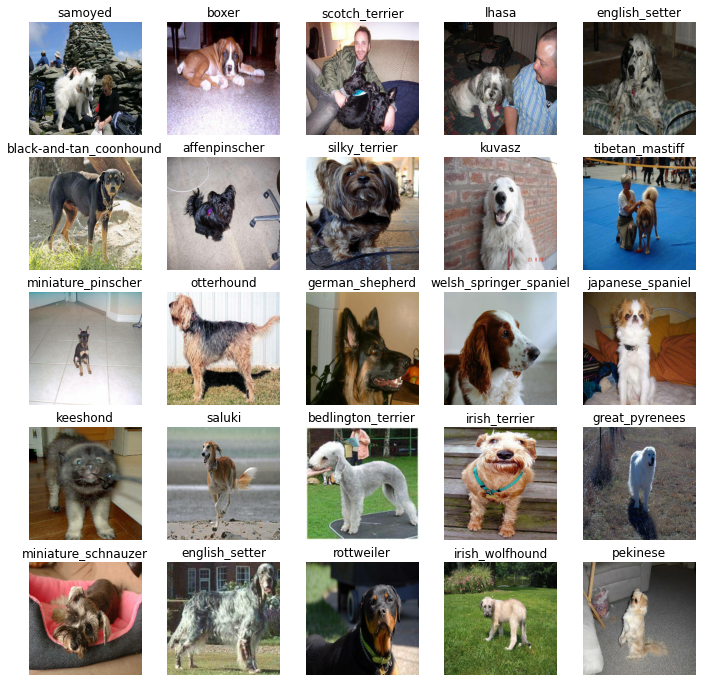

In [ ]:
# now let's visualize our data in a training batch
show_25_images(train_images, train_labels)
# to clean the mess below we will plot the axis off above.
# notice that images are in sq. format as we have resized 224,224

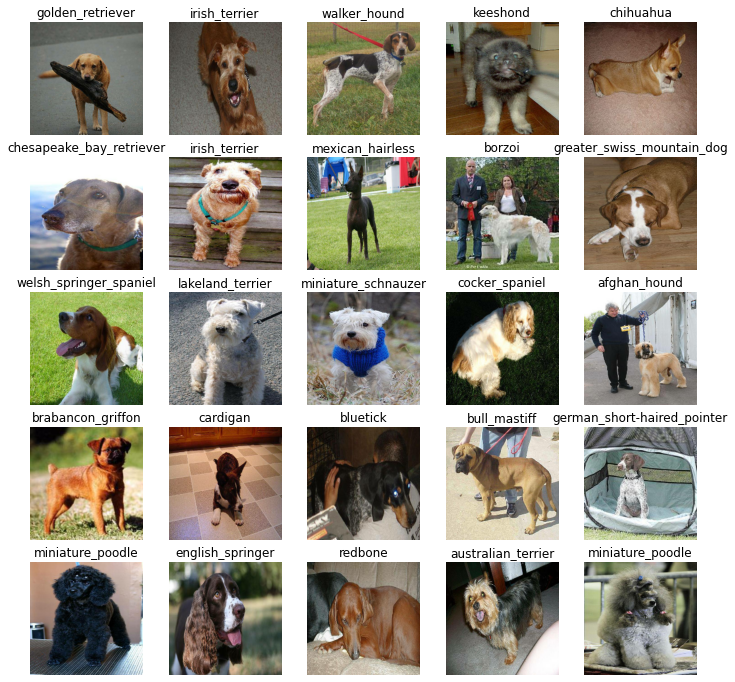

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)


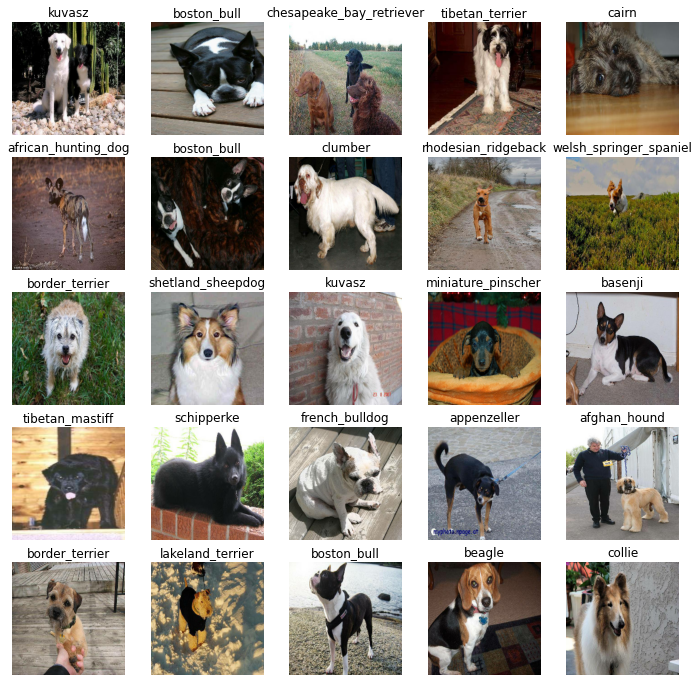

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)
# Notice that every time the images of dogs vary even after executing same codes, its because we have shuffled the training data.

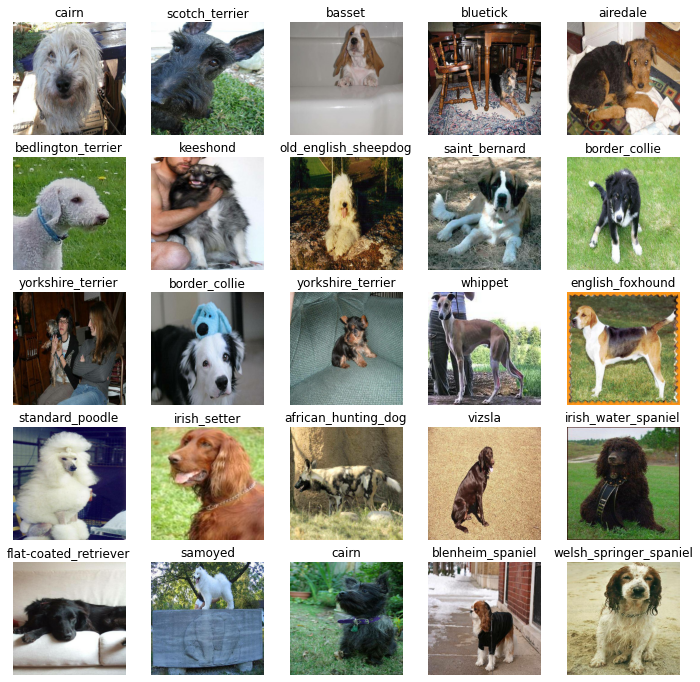

In [ ]:
# Now let's visualize our validation data
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

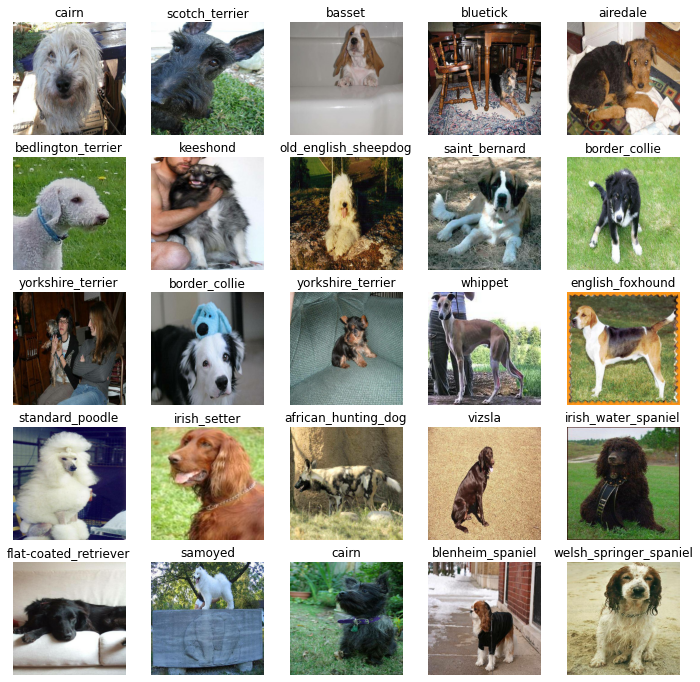

In [ ]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)
# notice that it returns the same images as we didn't used shuffle in validation dataset

## Building a model
Before we build our model, there are a few things we need to define:
* The input shape(our images shape, in the form of Tensors) to our model.
* The output shape(image labels, in the form of Tensors) of our model.
* The URL of the model we want to use from Tensorflow Hub 
https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, color channel

#Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from tensorflow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4"

Now we've got our inputs, outputs and model ready to go. Let's put them together into a Keras deep learning model!

Knowing this let's create a function which:
* Takes the input shape, output shape and the model we have chosen as parameter.
* Defines the layers in a keras model in sequential fashion (do this first, then this, then that).
* Compiles the model (says it should be evaluated and improved).
* Builds the model (tells the model the input shape it'll be getting).
* Returns the model.
* All of these steps can be found here:https://www.tensorflow.org/guide/keras/sequential_model

In [ ]:
# Create a function which builds a Keras model:
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with", MODEL_URL)

  #Setup the model layers
  # https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4  note that the model and build section can be checked directly from Usage section of the link.
  model = tf.keras.Sequential([
                               hub.KerasLayer(MODEL_URL),# layer1 (input layer)
                               tf.keras.layers.Dense(units = OUTPUT_SHAPE, #mobilenetv2 gives output shape(1x1x1280), but we want shape of our len(unique_breeds)
                                                     activation = "softmax") #layer2 (output layer)
  ])
  # Compile the model
  model.compile(
      loss= tf.keras.losses.CategoricalCrossentropy(),# loss🔼     model🔻
      optimizer= tf.keras.optimizers.Adam(),
      metrics =["accuracy"]
  )

  #Build the model:
  model.build(INPUT_SHAPE)
  return model

In [ ]:
model = create_model()
model.summary()

Building model with https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              2664345   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 2,784,585
Trainable params: 120,240
Non-trainable params: 2,664,345
_________________________________________________________________


In [ ]:
#Self - Practice
x = tf.ones((1,4))

In [ ]:
#Practice
x

<tf.Tensor: shape=(1, 4), dtype=float32, numpy=array([[1., 1., 1., 1.]], dtype=float32)>

# Creating callbacks
Callbacks are helper functions a model can use during training to do such things as save its progress,check its progress or stop training early if a model stops improving.
* We wil create two callbacks, one for Tensorboard which helps track our models progress and another for early stopping which prevents our model from training too long.

## Tensorboard callback
To setup a tensorboard callback, we need to do 3 things:
1. Load the tensorboard notebook extension✅
2. Create a Tensorboard callback which is able to save logs to a directory and pass it to our model's `fit()` function✅
3. Visualize our models training logs with the `%tensorboard` magic function (we'll do this after model training).

In [ ]:
# Load tensorboard notebook extension
%load_ext tensorboard 

In [ ]:
import datetime

# create a function to build a tensorboard callback
def create_tensorboard_callback():
  # ceate a log directory for storing tensorboard logs
  logdir = os.path.join("drive/ MyDrive/Dog_Vision_data/logs",
                        #Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping Callback
Early stopping helps our model from overfitting by stopping training if a certain evaluation mteric stops improving.
https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping


In [ ]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor = 'val_accuracy',
                                                  patience = 3)

# Training a model (on a subset of data)
Our first model is only going to train on 1000 images, to make sure evrything is working.

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10, max:100, steps:10}
# E.g : 1 epoch will ask 1 time to train our training data, similarly 100 epochs will ask 100  times to train the  training data. 

Let's create a function which trains a model.
* creating a model using `create_model()`.
* setup a tensorboard callback using `create_tensorboard_callback()`.
* Call the `fit()` function to our model passing it the training data, validation data, number of epochs to train for `NUM_EPOCHS` and the callbacks we'd like to use.
* Return the model.

In [ ]:
# Build a function to train and return a model
def train_model():
  """
  Trains a given model and returns a trained version
  """
  # Create a model
  model = create_model()

  #Create new Tensorbpard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #Fit the model to the data passing it the callbacks we created
  model.fit(x= train_data,
            epochs = NUM_EPOCHS,
            validation_data = val_data,
            validation_freq = 1,
            callbacks = [tensorboard, early_stopping])
  #Return the fitted model
  return model

In [ ]:
model = train_model()

Building model with https://tfhub.dev/google/imagenet/mobilenet_v2_075_224/classification/4
Epoch 1/100
25/25 [==============================] - 566s 22s/step - loss: 5.1616 - accuracy: 0.0563 - val_loss: 3.3132 - val_accuracy: 0.2500
Epoch 2/100
25/25 [==============================] - 4s 167ms/step - loss: 1.8229 - accuracy: 0.6152 - val_loss: 2.1478 - val_accuracy: 0.5050
Epoch 3/100
25/25 [==============================] - 4s 169ms/step - loss: 0.6214 - accuracy: 0.9232 - val_loss: 1.7600 - val_accuracy: 0.5800
Epoch 4/100
25/25 [==============================] - 4s 167ms/step - loss: 0.2569 - accuracy: 0.9939 - val_loss: 1.6447 - val_accuracy: 0.5900
Epoch 5/100
25/25 [==============================] - 4s 171ms/step - loss: 0.1431 - accuracy: 1.0000 - val_loss: 1.5885 - val_accuracy: 0.5950
Epoch 6/100
25/25 [==============================] - 4s 167ms/step - loss: 0.0989 - accuracy: 1.0000 - val_loss: 1.5612 - val_accuracy: 0.6100
Epoch 7/100
25/25 [==============================]

In [ ]:
# note that our model stops training after 8 epochs only, ideally it should have tried 100 times.  Since accuracy on validation data is not improving marginally 
# and  the model performs at 100% accuracy on the training data.

**Question:** It looks like our model is overfitting, because it's performing far  better on the training dataset than the validation dataset, what are some ways to prevent overffitting in deep learning neural networks?

**Note**: Overfitting to begin with is a good thing, it looks like our model is learning!!

### Checking the TensorBoard logs
The tensorboard magic functions (`%tensorboard`) will access the log directory we created earlier and visualize the content.

In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog_Vision_data/logs


<IPython.core.display.Javascript object>

## Making and evaluating prediction using a trained model


In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# Make predictions on the validation dataset(not used on the trained data)
predictions = model.predict(val_data, verbose =1)#if we don't set verbose=1, we won't get the progress bar next to 7/7 below.
predictions

7/7 [==============================] - 1s 118ms/step


array([[3.08705191e-03, 7.31106629e-05, 2.94781403e-05, ...,
        1.17289776e-04, 4.46068967e-04, 4.84010015e-05],
       [2.05461984e-04, 6.49466529e-06, 2.32053371e-05, ...,
        1.83247050e-06, 5.97729149e-06, 3.95948427e-06],
       [6.88224509e-06, 2.14981883e-05, 8.21925096e-06, ...,
        1.14903356e-04, 1.90712417e-05, 1.10784058e-04],
       ...,
       [1.11049185e-05, 5.22111877e-05, 1.18885218e-04, ...,
        6.51567461e-06, 6.52555900e-05, 1.56533904e-04],
       [4.79522947e-04, 4.58491513e-06, 5.88222356e-05, ...,
        1.70796629e-05, 6.16724574e-05, 3.23109259e-03],
       [4.84242810e-05, 2.52357167e-05, 3.53736756e-03, ...,
        9.03840933e-04, 6.43037865e-03, 1.03052601e-03]], dtype=float32)

In [ ]:
predictions.shape

(200, 120)

In [ ]:
len(y_val)

200

In [ ]:
len(unique_breeds)

120

In [ ]:
predictions[0] #note that it an array of 120 different numbers between (0-1), because of activation set to `softmax` in create_model func.
# So, the predictions is equal to 200 such arrays .

array([3.08705191e-03, 7.31106629e-05, 2.94781403e-05, 9.23430052e-05,
       3.81374179e-04, 3.18417806e-05, 2.50870246e-03, 4.44796897e-05,
       2.10815590e-04, 3.85817020e-06, 2.70019373e-04, 3.39559338e-05,
       2.28016543e-05, 3.33414118e-06, 1.78391165e-05, 9.24565484e-06,
       8.05258333e-06, 6.90281857e-03, 8.42572945e-07, 1.42792764e-04,
       1.11221438e-04, 2.13618187e-04, 6.54649830e-06, 2.28794850e-03,
       1.26120995e-05, 6.72154129e-04, 4.95416254e-01, 2.80987319e-06,
       8.56775878e-05, 6.29927090e-05, 3.58729958e-05, 3.83865496e-04,
       3.49869697e-05, 1.89336265e-06, 4.08209853e-05, 1.17394812e-02,
       8.68170446e-06, 2.67739142e-05, 3.41831474e-05, 5.75921767e-05,
       5.85777852e-05, 1.36728213e-05, 7.31650653e-05, 4.21171790e-05,
       3.99872260e-06, 4.49460131e-05, 1.78372629e-05, 1.47464580e-05,
       1.02760876e-02, 2.01432413e-05, 1.01938022e-04, 4.64689674e-06,
       1.10517361e-03, 7.91362545e-05, 6.54184551e-05, 7.20094158e-06,
      

In [ ]:
len(predictions[0]) 

120

After applying softmax, each component will be in the interval {\displaystyle (0,1)}(0,1), and the components will add up to 1, so that they can be interpreted as probabilities. Furthermore, the larger input components will correspond to larger probabilities.

> Note : Predictions[0] returns 120 numbers in an array, Here the model assigns a probability value to every single label ,the highest value in here is going to correponds to the index of the label that the model thinks is most likely.



In [ ]:
np.sum(predictions[0])

1.0000001

In [ ]:
np.sum(predictions[1]) #very close to 1 as expected.

1.0

In [ ]:
#First Prediction
index = 0
print(f"Max value(probability of prediction): {np.max(predictions[index])}")
print(f"Sum:{np.sum(predictions[index])}")
print(f"Max Index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")



Max value(probability of prediction): 0.4954162538051605
Sum:1.0000001192092896
Max Index: 26
Predicted label: cairn


In [ ]:
unique_breeds[59]

'irish_wolfhound'

In [ ]:
#First Prediction
index = 42
print(f"Max value(probability of prediction): {np.max(predictions[index])}")
print(f"Sum:{np.sum(predictions[index])}")
print(f"Max Index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")



Max value(probability of prediction): 0.5949920415878296
Sum:1.0
Max Index: 39
Predicted label: english_foxhound


In [ ]:
predictions[0]

array([3.08705191e-03, 7.31106629e-05, 2.94781403e-05, 9.23430052e-05,
       3.81374179e-04, 3.18417806e-05, 2.50870246e-03, 4.44796897e-05,
       2.10815590e-04, 3.85817020e-06, 2.70019373e-04, 3.39559338e-05,
       2.28016543e-05, 3.33414118e-06, 1.78391165e-05, 9.24565484e-06,
       8.05258333e-06, 6.90281857e-03, 8.42572945e-07, 1.42792764e-04,
       1.11221438e-04, 2.13618187e-04, 6.54649830e-06, 2.28794850e-03,
       1.26120995e-05, 6.72154129e-04, 4.95416254e-01, 2.80987319e-06,
       8.56775878e-05, 6.29927090e-05, 3.58729958e-05, 3.83865496e-04,
       3.49869697e-05, 1.89336265e-06, 4.08209853e-05, 1.17394812e-02,
       8.68170446e-06, 2.67739142e-05, 3.41831474e-05, 5.75921767e-05,
       5.85777852e-05, 1.36728213e-05, 7.31650653e-05, 4.21171790e-05,
       3.99872260e-06, 4.49460131e-05, 1.78372629e-05, 1.47464580e-05,
       1.02760876e-02, 2.01432413e-05, 1.01938022e-04, 4.64689674e-06,
       1.10517361e-03, 7.91362545e-05, 6.54184551e-05, 7.20094158e-06,
      

In [ ]:
unique_breeds[np.argmax(predictions[0])]

'cairn'

Having the above functionality is great but we want to be able to do it at a scale.
* It would be even better if we could see the image the prediction is being made on.
* Note : Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn prediction probabilities into their respective labels(easier to understand)
def get_pred_labels(prediction_probabilities):
  """
  Turns an array of prediction probabilites into a label
  """
  return unique_breeds[np.argmax(prediction_probabilities)]



In [ ]:
get_pred_labels(predictions[1])

'scotch_terrier'

Now since our validation data is still in a batch dataset, we'll have to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels(truth labels)

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
images_=[]
labels_=[]

#Loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)


In [ ]:
images_[0], labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
get_pred_labels(predictions[0])

'cairn'

In [ ]:
get_pred_labels(labels_[0]) #Note that our model predicted wrong.

'cairn'

In [ ]:
#Create a function to unbatchify the batch dataset
def unbatchify(data):
  """
  Takes batched dataset of (image,label) tensors and returns seperate arrays of images and labels.
  """
  images =[]
  labels =[]
  for image,label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images,labels

In [ ]:
#Unbatchify the validation dataset
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
get_pred_labels(val_labels[0])

'affenpinscher'

Now that we have got ways to get:
* Prediction labels
* Validation labels(truth labels)
* Validation images 
> Let's make function to make these all a bit more visualize.
We'll create a function which:

* Takes an array of prediction probabilities, an array of truth label and an array of images and integers
* Convert the prediction probabiilties to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.


In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and images for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  #Get the pred label
  pred_labels = get_pred_labels(pred_prob)

  #Plot  image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  #Change the color of the title on if the prediction is right or wrong
  if pred_labels== true_label:
    color = "green"
  else:
    color = "red"
  


  # Change plot title to be predicted, probability of predictions and truth label
  plt.title("{} {:2.0f}% {}".format(pred_labels,
                                    np.max(pred_prob)*100,
                                    true_label),
            color = color)

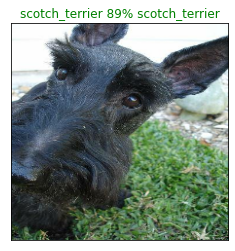

In [ ]:
plot_pred(prediction_probabilities= predictions,
          labels = val_labels,
          images = val_images,
          )

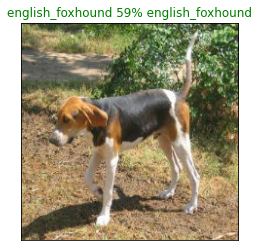

In [ ]:
plot_pred(prediction_probabilities= predictions,
          labels = val_labels,
          images = val_images,
          n=42)

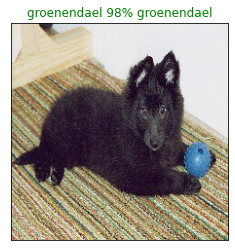

In [ ]:
plot_pred(prediction_probabilities= predictions,
          labels = val_labels,
          images = val_images,
          n=77)

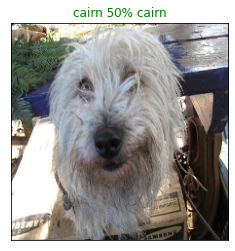

In [ ]:
plot_pred(prediction_probabilities= predictions,
          labels = val_labels,
          images = val_images,
          n=0)

Now that we have got one function to visualize our models top prediction, let's make another to view our models top 10 predictions.

This function will:
* Take an input of prediction probabilities array and a ground truth array and an integer.
* Find prediction using `get_pred_labels()`
* Find top 10:
  * Prediction probabilities indexes
  * Prediction probabilites values
  * Prediction lables

* Plot the top 10 prediction probabilites values and labels, colouring the true label green.

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted labels
  pred_label = get_pred_label(pred_prob)
  
  #Find the top 10 predction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  #Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  #Find the top 10 prediction labels
  top_10_pred_lables = unique_breed[top_10_pred_indexes]

  #Setup plot 
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
  )

In [ ]:
predictions[0]

array([3.08705191e-03, 7.31106629e-05, 2.94781403e-05, 9.23430052e-05,
       3.81374179e-04, 3.18417806e-05, 2.50870246e-03, 4.44796897e-05,
       2.10815590e-04, 3.85817020e-06, 2.70019373e-04, 3.39559338e-05,
       2.28016543e-05, 3.33414118e-06, 1.78391165e-05, 9.24565484e-06,
       8.05258333e-06, 6.90281857e-03, 8.42572945e-07, 1.42792764e-04,
       1.11221438e-04, 2.13618187e-04, 6.54649830e-06, 2.28794850e-03,
       1.26120995e-05, 6.72154129e-04, 4.95416254e-01, 2.80987319e-06,
       8.56775878e-05, 6.29927090e-05, 3.58729958e-05, 3.83865496e-04,
       3.49869697e-05, 1.89336265e-06, 4.08209853e-05, 1.17394812e-02,
       8.68170446e-06, 2.67739142e-05, 3.41831474e-05, 5.75921767e-05,
       5.85777852e-05, 1.36728213e-05, 7.31650653e-05, 4.21171790e-05,
       3.99872260e-06, 4.49460131e-05, 1.78372629e-05, 1.47464580e-05,
       1.02760876e-02, 2.01432413e-05, 1.01938022e-04, 4.64689674e-06,
       1.10517361e-03, 7.91362545e-05, 6.54184551e-05, 7.20094158e-06,
      

In [ ]:
predictions[0].argsort() # total values below are 120 , the highest value is rated 1

array([ 56,  18,  99,  74,  33,  84,  27,  95,  13,  63,  86,   9,  44,
        60,  51,  22,  55,  16,  36,  15,  58, 105,  24,  85,  41,  47,
        61,  46,  14,  71,  49, 115,  12,  92, 114,  37,  94,   2,   5,
       113,  11,  38, 104,  88,  32,  30, 107,  69,  34,  43,   7,  45,
       111,  76, 119,  90,  67, 112,  75,  89,  79,  39,  40,  62,  29,
       101,  97,  54,  96,   1,  42, 108,  53,  28,   3,  50,  20,  57,
       117,  87,  91,  78,  19, 102,   8,  21,  10,  64,  80,  66,   4,
        31, 106, 118,  98,  93, 110,  72,  25,  52, 109,  83,  23,   6,
        81,   0,  77,  59,  68,  17, 100, 116,  48,  35,  65,  82,  73,
        70, 103,  26])

In [ ]:
predictions[0].argsort()[-10:] # this is the top 10 indexes

array([100, 116,  48,  35,  65,  82,  73,  70, 103,  26])

In [ ]:
predictions[0].argsort()[-10:][::-1] #reversing the above order.

array([ 26, 103,  70,  73,  82,  65,  35,  48, 116, 100])

In [ ]:
# If we want the exact values of the indexes
predictions[0][predictions[0].argsort()[-10:][::-1]]

array([0.49541625, 0.2349025 , 0.09507099, 0.0363096 , 0.03197159,
       0.02330752, 0.01173948, 0.01027609, 0.00736811, 0.00729045],
      dtype=float32)

In [ ]:
predictions[0].max()

0.49541625

In [ ]:
unique_breeds[predictions[0].argsort()[-10:][::-1]]

array(['cairn', 'soft-coated_wheaten_terrier', 'lhasa', 'maltese_dog',
       'old_english_sheepdog', 'komondor', 'dandie_dinmont',
       'giant_schnauzer', 'west_highland_white_terrier', 'shih-tzu'],
      dtype=object)